In [1]:
from pymongo import ASCENDING, GEOSPHERE, MongoClient
import pandas as pd
from alive_progress import alive_bar
from shapely.geometry import Point, mapping
from keplergl import KeplerGl
import shapely
import json
from os import listdir
from os.path import isfile, join
from tqdm import tqdm
import geopandas as gpd
from h3 import h3
import math
import sklearn
import numpy as np
import time

In [2]:
import hdbscan
import sklearn.cluster as cluster
from sklearn.metrics import adjusted_rand_score, adjusted_mutual_info_score

In [3]:
import umap.umap_ as umap

In [4]:
client = MongoClient('mongodb://192.168.0.109:27017/')
db = client.osmDataDB
coll_areas = db.areas
coll_cities = db.cities
coll_relations = db.relationsFiltered
coll_hexes = db.hexesInCitiesFiltered
coll_vectors = db.hexEmbeddingCacheBaseCountCategoryEmbedding
# coll_relations = db.relations

In [180]:
import seaborn as sns
import matplotlib.pyplot as plt
# sns.set_theme()
sns.set_style("whitegrid")
# sns.set_style("white")
sns.set_context("paper", font_scale=6, rc={"lines.linewidth": 2})
# sns.set_context("paper")

In [6]:
vectors = np.array([coll_vectors.find_one({ 'hex_id': v['hex_id']}, {'vector': 1})['vector'] for v in tqdm(coll_hexes.find({'resolution': 9, 'has_station': True}, {'hex_id': 1}))])

9304it [00:06, 1510.03it/s]


In [157]:
geometries = np.array([v['geometry'] for v in tqdm(coll_hexes.find({'resolution': 9, 'has_station': True}, {'geometry': 1}))])

9304it [00:05, 1625.23it/s]


In [7]:
vectors

array([[0., 0., 0., ..., 0., 2., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 4., 0.],
       [0., 0., 0., ..., 2., 7., 0.]])

In [8]:
from sklearn.preprocessing import MinMaxScaler
def normalize_x(x):
    new_array = np.zeros(x.shape)
    for i in range(x.shape[1]):
        vector = x[:,i].reshape((-1,1))
        scaler = MinMaxScaler()
        new_array[:,i] = scaler.fit_transform(vector).reshape((-1,))
    return new_array

In [9]:
norm_vectors = normalize_x(vectors)

In [32]:
clusterable_embedding = umap.UMAP(
    # n_neighbors=30,
    n_neighbors=15,
    min_dist=0.0,
    n_components=2,
    random_state=42,
).fit_transform(vectors)

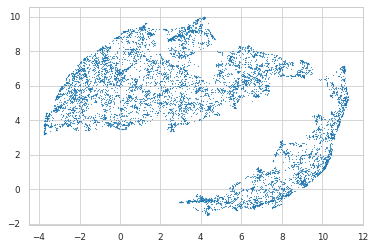

In [33]:
plt.scatter(clusterable_embedding[:, 0], clusterable_embedding[:, 1], s=0.1, cmap='Spectral');

In [36]:
labels = hdbscan.HDBSCAN(
    min_samples=10,
    min_cluster_size=50,
).fit_predict(clusterable_embedding)

In [37]:
np.unique(labels)

array([-1,  0,  1])

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


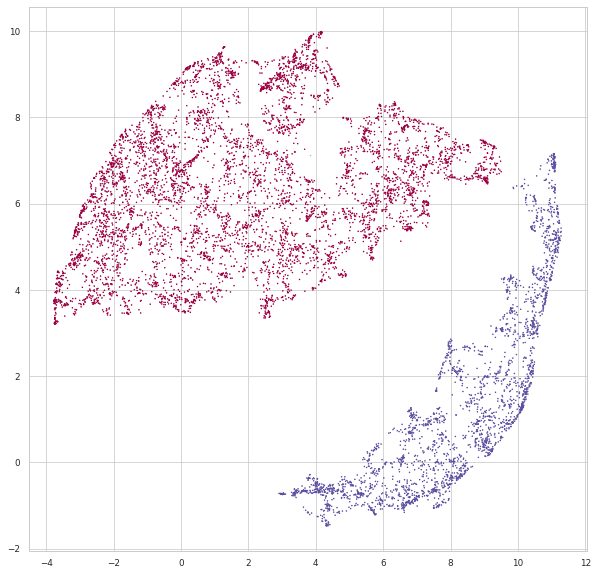

In [38]:
clustered = (labels >= 0)
plt.figure(figsize=(10,10))
plt.scatter(clusterable_embedding[~clustered, 0],
            clusterable_embedding[~clustered, 1],
            c=(0.5, 0.5, 0.5),
            s=0.5,
            alpha=0.5)
plt.scatter(clusterable_embedding[clustered, 0],
            clusterable_embedding[clustered, 1],
            c=labels[clustered],
            s=0.5,
            cmap='Spectral');
plt.show()

In [45]:
clusterable_embedding = umap.UMAP(
    # n_neighbors=30,
    n_neighbors=15,
    min_dist=0.0,
    n_components=2,
    random_state=42,
).fit_transform(norm_vectors)

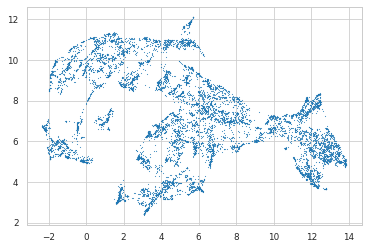

In [42]:
plt.scatter(clusterable_embedding[:, 0], clusterable_embedding[:, 1], s=0.1, cmap='Spectral');

In [67]:
labels = hdbscan.HDBSCAN(
    min_samples=50,
    min_cluster_size=800,
).fit_predict(clusterable_embedding)
np.unique(labels)

array([-1,  0,  1,  2,  3])

In [125]:
categories = [(0, 'aerialway'),
 (1, 'airports'),
 (2, 'buildings'),
 (3, 'culture_art_entertainment'),
 (4, 'education'),
 (5, 'emergency'),
 (6, 'finances'),
 (7, 'healthcare'),
 (8, 'historic'),
 (9, 'leisure'),
 (10, 'other'),
 (11, 'roads_bike'),
 (12, 'roads_drive'),
 (13, 'roads_walk'),
 (14, 'shops'),
 (15, 'sport'),
 (16, 'sustenance'),
 (17, 'tourism'),
 (18, 'transportation'),
 (19, 'water')]

In [170]:
categories_raw = [c[1] for c in categories]

In [138]:
rows = []
for (vector, label, norm_vector) in zip(vectors, labels, norm_vectors):
    if label >= 0:
        for idx in range(20):
            row = {
                'label': label,
                'category': categories[idx][1],
                'Category': '',
                'value': vector[idx],
                'value_norm': norm_vector[idx],
            }
            rows.append(row)

In [139]:
df = pd.DataFrame(rows)
df

,label,category,Category,value,value_norm
0,1,aerialway,,0.0,0.000000
1,1,airports,,0.0,0.000000
2,1,buildings,,0.0,0.000000
3,1,culture_art_entertainment,,0.0,0.000000
4,1,education,,0.0,0.000000
...,...,...,...,...,...
176535,3,sport,,1.0,0.023256
176536,3,sustenance,,1.0,0.008547
176537,3,tourism,,2.0,0.017241
176538,3,transportation,,7.0,0.132075


In [171]:
df.loc[df.category.isin(categories_raw[:10])]

,label,category,Category,value,value_norm
0,1,aerialway,,0.0,0.000000
1,1,airports,,0.0,0.000000
2,1,buildings,,0.0,0.000000
3,1,culture_art_entertainment,,0.0,0.000000
4,1,education,,0.0,0.000000
...,...,...,...,...,...
176525,3,emergency,,0.0,0.000000
176526,3,finances,,0.0,0.000000
176527,3,healthcare,,0.0,0.000000
176528,3,historic,,0.0,0.000000


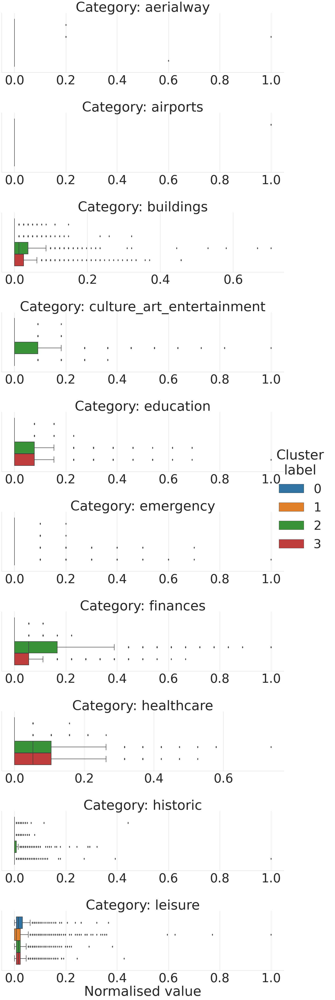

In [188]:
# plt.figure(figsize=(12, 21))
g = sns.catplot(
    data=df.loc[df.category.isin(categories_raw[:10])],
    x='value_norm',
    y='Category',
    hue='label',
    kind="box",
    orient="h", 
    height=6,
    aspect=3,
    row='category',
    # dodge=True,
    sharex=False
)

# g.map(set_scale, 'metric', color='k', alpha=0.5)
g.set_axis_labels("Normalised value", "")
# g.map(mean_line, res color='k', ls='--')
# g.set_axis_labels("Neighbourhood size", "Metric value")
# g.set_axis_labels("Metric value", "Imbalance ratio")
# g.set_titles("Metric: {row_name}")
# g.set_titles("Resolution: {row_name}\nMetric:\n{row_name}")
g.set_titles("Category: {row_name}")

# # g.fig.subplots_adjust(wspace=0.1, hspace=0.55)
# g.fig.subplots_adjust(top=0.95) # adjust the Figure in rp
# # g.fig.suptitle(f'Distribution of the number of POIs per cluster')
# # g.fig.suptitle(f'Distribution of the number', horizontalalignment='left')
# # g.fig.suptitle(f'Distribution of the number', horizontalalignment='right')
# g.fig.suptitle(f'of POIs per cluster', horizontalalignment='right')

# # plt.legend(title='City')
# handles = g._legend.legendHandles
# line = mlines.Line2D([0], [0], label='Mean value', color="k", ls='--')
# handles.append(line)
# g._legend.legendHandles = handles

g._legend.set_title("Cluster\nlabel")
g._legend.get_title().set_multialignment('center')


plt.savefig(f'bicycle_cluster_categories_part_1.pdf', dpi=300, format='pdf', bbox_inches='tight')
# plt.savefig(f'transfer_learning_stations_recall.png', dpi=300, format='png', bbox_inches='tight')
plt.show()
# g.set_xscale('log')
# sns.despine(offset=10, trim=True)

/home/raczeq/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/raczeq/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


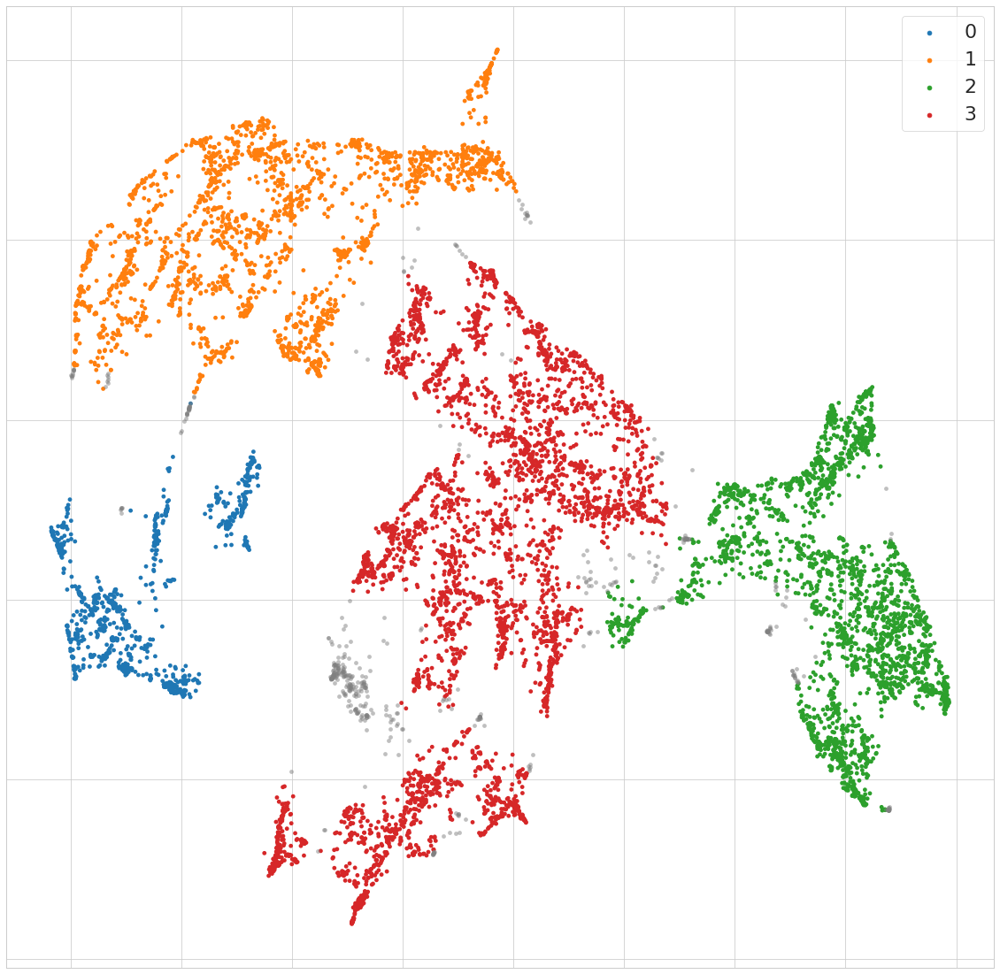

In [156]:
clustered = (labels >= 0)
plt.figure(figsize=(20,20))

ax = sns.scatterplot(clusterable_embedding[clustered, 0],
            clusterable_embedding[clustered, 1],
            hue=labels[clustered],
            # s=0.5,
            linewidth=0,
            # cmap='rainbow'
            palette='tab10',
            # cmap=['royalblue','orange','green','red']
            );
sns.scatterplot(clusterable_embedding[~clustered, 0],
            clusterable_embedding[~clustered, 1],
            c=(0.5, 0.5, 0.5),
            # s=0.5,
            ax = ax,
            linewidth=0,
            alpha=0.5)
sns.despine(top=False, right=False, left=False, bottom=False)
ax.set(xticklabels=[], yticklabels=[])
# g2.set(title='Gender (0=Male, 1=Female, 2=Other)')
ax.set(xlabel=None, ylabel=None)
plt.savefig(f'umap_clusters.pdf', dpi=300, format='pdf', bbox_inches='tight')
plt.show()

In [164]:
for label in np.unique(labels):
    dicts = []
    for geom, l in zip(geometries, labels):
        if l == label:
            dicts.append({
                'geometry': shapely.geometry.shape(geom),
                'label': label
            })
    gpd.GeoDataFrame(dicts).to_file(f"hexes_label_{label}.geojson", driver='GeoJSON')

In [163]:
gpd.GeoDataFrame(dicts).to_file(f"hexes_labels.geojson", driver='GeoJSON')

In [71]:
mean_values = { l: np.zeros((20,)) for l in labels }
sums = { l: 0 for l in labels }

In [72]:
for (vector, label, norm_vector) in zip(vectors, labels, norm_vectors):
    mean_values[label] += vector
    sums[label] += 1

In [73]:
sums

{1: 2033, 3: 3691, 2: 2254, 0: 849, -1: 477}

In [75]:
for k, v in mean_values.items():
    mean_values[k] /= sums[k]

In [76]:
mean_values

{1: array([3.44318741e-03, 0.00000000e+00, 4.50565667e-01, 2.60698475e-02,
        4.57452041e-02, 1.27889818e-02, 8.95228726e-02, 1.35268077e-01,
        1.81505165e-01, 2.79390064e+00, 5.41072307e-03, 2.74638465e+01,
        4.75159862e-01, 1.99631087e+01, 1.68027545e+00, 1.03689129e+00,
        1.09099852e+00, 7.31431382e-01, 2.45597639e+00, 2.20855878e-01]),
 3: array([8.12787862e-04, 0.00000000e+00, 1.34191276e+00, 2.83933893e-01,
        6.23679220e-01, 1.44405310e-01, 1.01842319e+00, 1.16526687e+00,
        5.64616635e-01, 2.46572745e+00, 5.41858575e-03, 2.03725278e+01,
        1.60931997e-01, 3.55998374e+01, 8.60931997e+00, 5.22622596e-01,
        5.21565971e+00, 1.88160390e+00, 6.41506367e+00, 1.12706584e-01]),
 2: array([ 0.        ,  0.        ,  2.12200532,  0.6242236 ,  0.75465839,
         0.17480035,  1.95607808,  1.527063  ,  1.01508429,  2.49423248,
         1.23913043, 22.30745342,  0.15039929, 40.52040816, 15.98669033,
         0.54747116, 10.35891748,  2.95430346,  

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


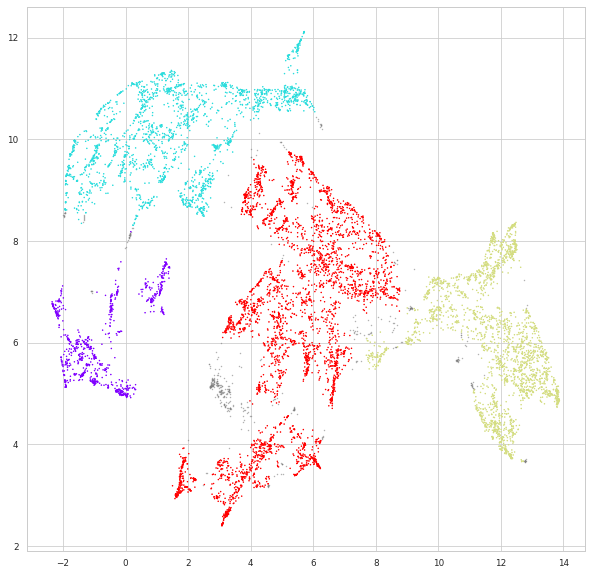

In [69]:
clustered = (labels >= 0)
plt.figure(figsize=(10,10))
plt.scatter(clusterable_embedding[~clustered, 0],
            clusterable_embedding[~clustered, 1],
            c=(0.5, 0.5, 0.5),
            s=0.5,
            alpha=0.5)
plt.scatter(clusterable_embedding[clustered, 0],
            clusterable_embedding[clustered, 1],
            c=labels[clustered],
            s=0.5,
            cmap='rainbow');
plt.show()

In [52]:
labels = hdbscan.HDBSCAN(
    min_samples=50,
    min_cluster_size=100,
).fit_predict(clusterable_embedding)
np.unique(labels)

array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13])

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


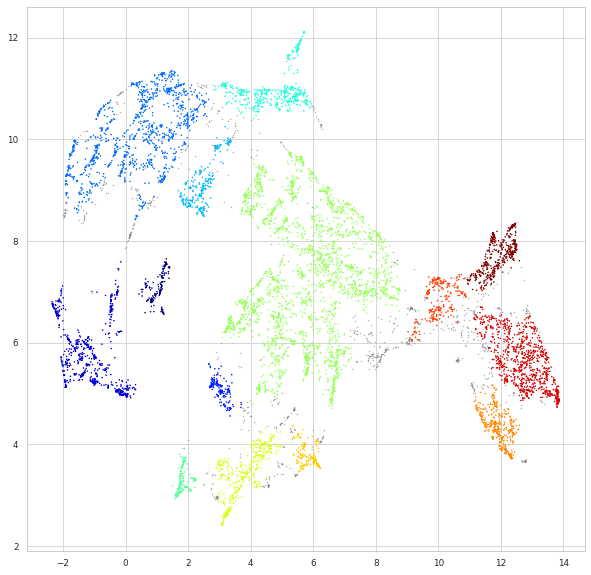

In [56]:
clustered = (labels >= 0)
plt.figure(figsize=(10,10))
plt.scatter(clusterable_embedding[~clustered, 0],
            clusterable_embedding[~clustered, 1],
            c=(0.5, 0.5, 0.5),
            s=0.5,
            alpha=0.5)
plt.scatter(clusterable_embedding[clustered, 0],
            clusterable_embedding[clustered, 1],
            c=labels[clustered],
            s=0.5,
            cmap='jet');
plt.show()

In [11]:
def draw_umap(data, n_neighbors=15, min_dist=0.1, n_components=2, metric='euclidean', title=''):
    fit = umap.UMAP(
        n_neighbors=n_neighbors,
        min_dist=min_dist,
        n_components=n_components,
        metric=metric
    )
    u = fit.fit_transform(data);
    fig = plt.figure()
    if n_components == 1:
        ax = fig.add_subplot(111)
        ax.scatter(u[:,0], range(len(u)))
    if n_components == 2:
        ax = fig.add_subplot(111)
        ax.scatter(u[:,0], u[:,1])
    if n_components == 3:
        ax = fig.add_subplot(111, projection='3d')
        ax.scatter(u[:,0], u[:,1], u[:,2], s=100)
    plt.title(title, fontsize=18)

/home/raczeq/anaconda3/lib/python3.8/site-packages/umap/spectral.py:255: UserWarning: WARNING: spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(


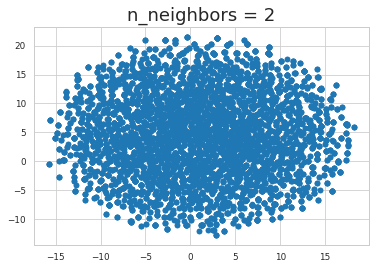

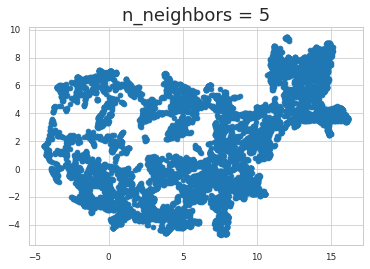

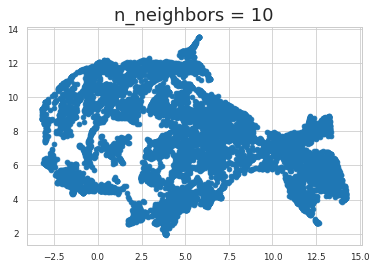

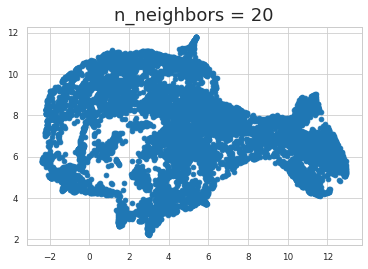

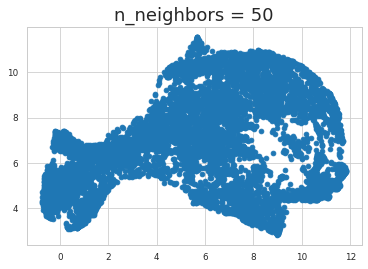

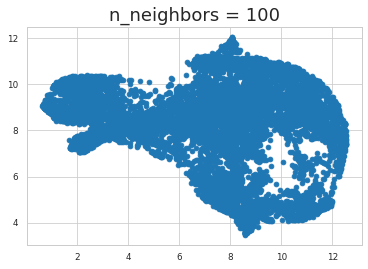

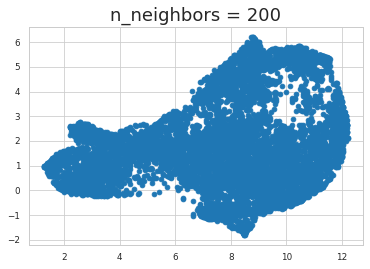

In [59]:
for n in (2, 5, 10, 20, 50, 100, 200):
    draw_umap(norm_vectors, n_neighbors=n, title='n_neighbors = {}'.format(n))

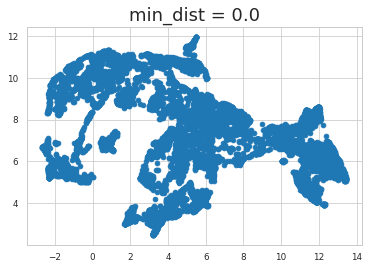

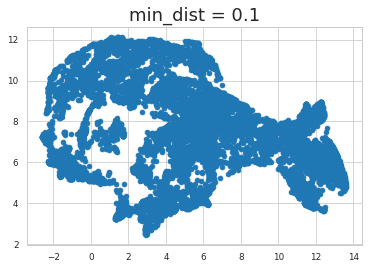

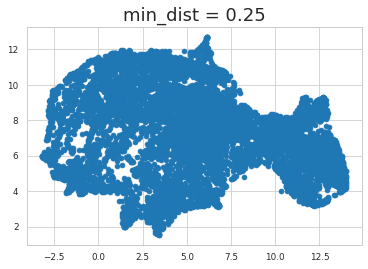

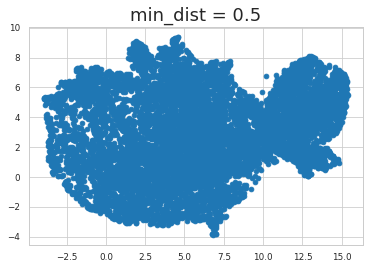

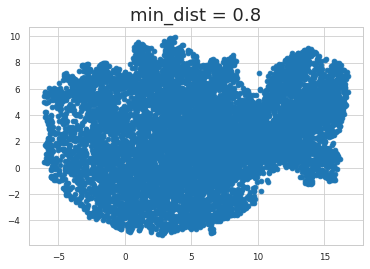

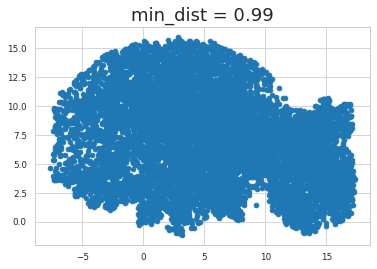

In [60]:
for d in (0.0, 0.1, 0.25, 0.5, 0.8, 0.99):
    draw_umap(norm_vectors, min_dist=d, title='min_dist = {}'.format(d))

100%|██████████| 6/6 [01:31<00:00, 15.17s/it]


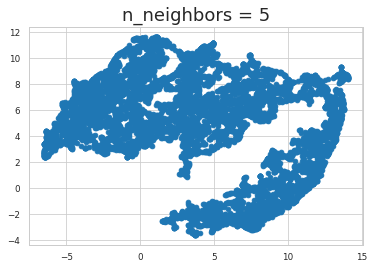

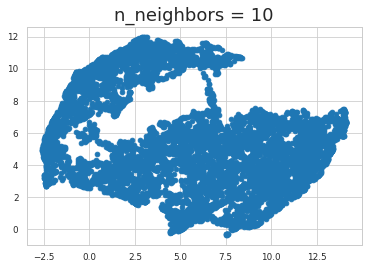

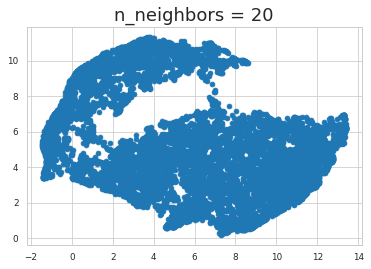

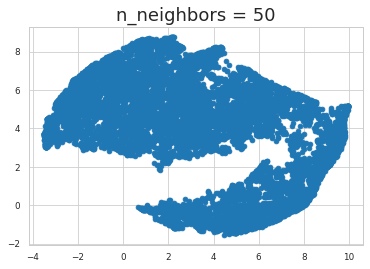

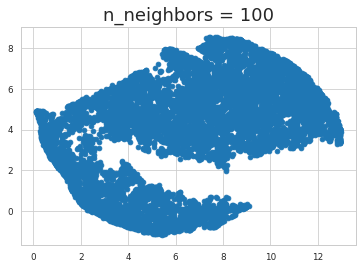

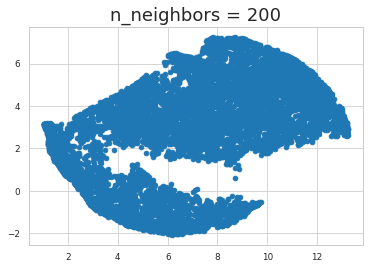

In [16]:
# for n in tqdm((2, 5, 10, 20, 50, 100, 200)):
for n in tqdm((5, 10, 20, 50, 100, 200)):
    draw_umap(vectors, n_neighbors=n, title='n_neighbors = {}'.format(n))

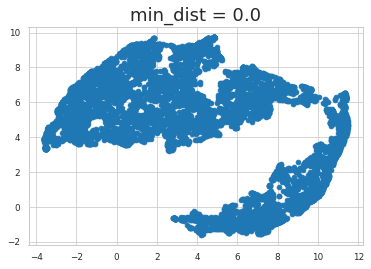

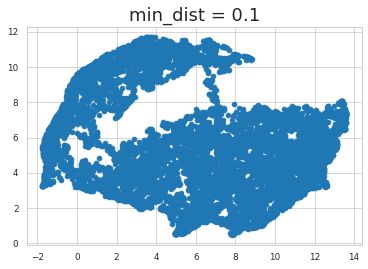

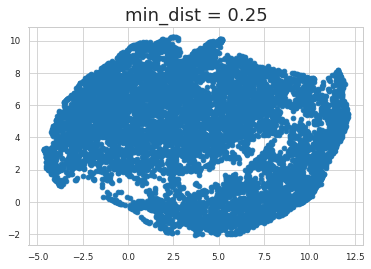

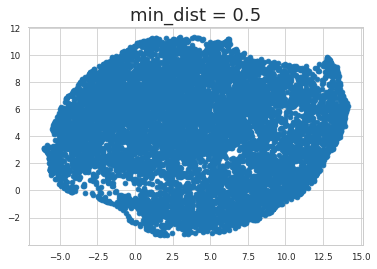

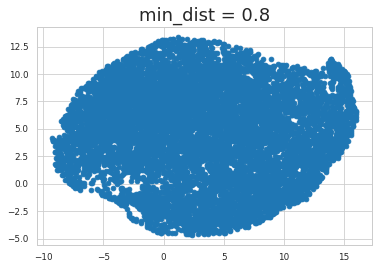

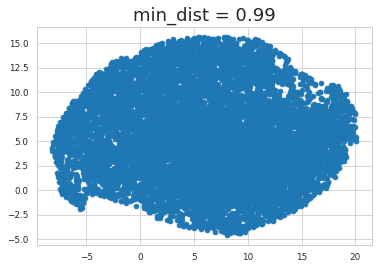

In [14]:
for d in (0.0, 0.1, 0.25, 0.5, 0.8, 0.99):
    draw_umap(vectors, min_dist=d, title='min_dist = {}'.format(d))